### The objective of this study is to analyze the flight booking dataset obtained from the “Ease My Trip” website and conduct various statistical hypothesis tests to extract meaningful insights. Regression analysis will be used to train the dataset and predict a continuous target variable. 'EaseMyTrip' is an online platform for booking flight tickets, serving as a resource for potential passengers to purchase tickets. A thorough examination of the data may provide valuable insights that could benefit both passengers and airlines.

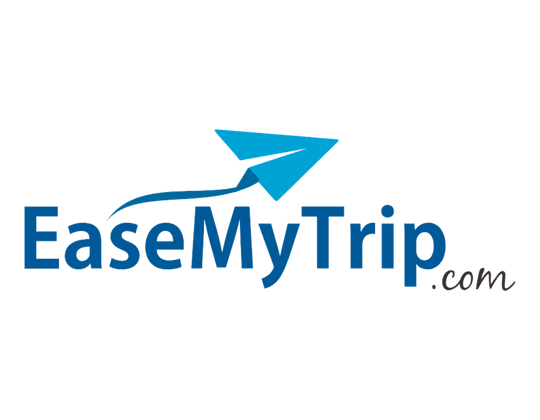

### 1 ) Library Imports 

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns 
import matplotlib.pyplot as plt 
%matplotlib inline
import plotly.express as px
from ipywidgets import interact, widgets
from IPython.display import display
import warnings
warnings.filterwarnings('ignore')

### 2 ) Data Exploration

In [2]:
economy = pd.read_csv("economy.csv")
business = pd.read_csv("business.csv")

In [3]:
economy.head()

,date,airline,ch_code,num_code,dep_time,from,time_taken,stop,arr_time,to,price
0,11-02-2022,SpiceJet,SG,8709,18:55,Delhi,02h 10m,non-stop,21:05,Mumbai,"5,953"
1,11-02-2022,SpiceJet,SG,8157,06:20,Delhi,02h 20m,non-stop,08:40,Mumbai,"5,953"
2,11-02-2022,AirAsia,I5,764,04:25,Delhi,02h 10m,non-stop,06:35,Mumbai,"5,956"
3,11-02-2022,Vistara,UK,995,10:20,Delhi,02h 15m,non-stop,12:35,Mumbai,"5,955"
4,11-02-2022,Vistara,UK,963,08:50,Delhi,02h 20m,non-stop,11:10,Mumbai,"5,955"


In [4]:
rows1, cols1 = economy.shape
print(f"Economy DataFrame contains {rows1} rows and {cols1} columns.")

Economy DataFrame contains 206774 rows and 11 columns.


In [5]:
business.head()

,date,airline,ch_code,num_code,dep_time,from,time_taken,stop,arr_time,to,price
0,11-02-2022,Air India,AI,868,18:00,Delhi,02h 00m,non-stop,20:00,Mumbai,"25,612"
1,11-02-2022,Air India,AI,624,19:00,Delhi,02h 15m,non-stop,21:15,Mumbai,"25,612"
2,11-02-2022,Air India,AI,531,20:00,Delhi,24h 45m,1-stop\n\t\t\t\t\t\t\t\t\t\t\t\t\n\t\t\t\t\t\t...,20:45,Mumbai,"42,220"
3,11-02-2022,Air India,AI,839,21:25,Delhi,26h 30m,1-stop\n\t\t\t\t\t\t\t\t\t\t\t\t\n\t\t\t\t\t\t...,23:55,Mumbai,"44,450"
4,11-02-2022,Air India,AI,544,17:15,Delhi,06h 40m,1-stop\n\t\t\t\t\t\t\t\t\t\t\t\t\n\t\t\t\t\t\t...,23:55,Mumbai,"46,690"


In [6]:
rows2, cols2 = business.shape
print(f"Business DataFrame contains {rows2} rows and {cols2} columns.")

Business DataFrame contains 93487 rows and 11 columns.


In [7]:
# Adding a 'Class' column to indicate the ticket class for each dataset  
economy['Class'] = "Economy"
business['Class'] = "Business"

In [8]:
# Merging the economy and business ticket datasets into a single DataFrame  
# Setting ignore_index=True to reset the index after concatenation  
df=pd.concat([economy,business] , ignore_index=True)
df.sample(5)

,date,airline,ch_code,num_code,dep_time,from,time_taken,stop,arr_time,to,price,Class
61574,11-02-2022,Air India,AI,631,19:20,Mumbai,19h 10m,2+-stop,14:30,Kolkata,"13,003",Economy
152496,30-03-2022,Vistara,UK,772,10:25,Kolkata,12h 40m,1-stop\n\t\t\t\t\t\t\t\t\t\t\t\t\n\t\t\t\t\t\t...,23:05,Chennai,"7,021",Economy
68140,20-03-2022,Air India,AI,660,18:00,Mumbai,15h 00m,1-stop\n\t\t\t\t\t\t\t\t\t\t\t\t\n\t\t\t\t\t\t...,09:00,Kolkata,"4,977",Economy
171831,21-02-2022,Vistara,UK,659,11:00,Hyderabad,08h 35m,2+-stop,19:35,Kolkata,"16,423",Economy
225431,15-02-2022,Vistara,UK,821,06:45,Mumbai,17h 10m,1-stop\n\t\t\t\t\t\t\t\t\t\t\t\t\n\t\t\t\t\t\t...,23:55,Delhi,"51,372",Business


In [9]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 300261 entries, 0 to 300260
Data columns (total 12 columns):
 #   Column      Non-Null Count   Dtype 
---  ------      --------------   ----- 
 0   date        300261 non-null  object
 1   airline     300261 non-null  object
 2   ch_code     300261 non-null  object
 3   num_code    300261 non-null  int64 
 4   dep_time    300261 non-null  object
 5   from        300261 non-null  object
 6   time_taken  300261 non-null  object
 7   stop        300261 non-null  object
 8   arr_time    300261 non-null  object
 9   to          300261 non-null  object
 10  price       300261 non-null  object
 11  Class       300261 non-null  object
dtypes: int64(1), object(11)
memory usage: 27.5+ MB


### 3 ) Data Cleaning and Feature Engineering

In [10]:
# Checking for missing values in the Dataset
df.isna().sum()

date          0
airline       0
ch_code       0
num_code      0
dep_time      0
from          0
time_taken    0
stop          0
arr_time      0
to            0
price         0
Class         0
dtype: int64

In [11]:
#check_duplicates
df.duplicated().sum()

2

In [12]:
# Removing duplicate records from the Dataset
df.drop_duplicates(inplace=True)

In [13]:
#renamming columns to expressive names
df.rename(columns={
    'dep_time': 'departure_time',
    'arr_time': 'arrival_time',
    'stop': 'stops',
    'from':'From'
}, inplace=True)

In [14]:
# Concatenating 'ch_code' and 'num_code' into 'flight_info'
df['flight_code'] = df['ch_code'] + '-' + df['num_code'].astype(str)
df.drop(columns=['ch_code', 'num_code'], inplace=True)

In [15]:
# convert date column from object to datetime
df['date'] = pd.to_datetime(df['date'],errors='coerce',format='%d-%m-%Y')

In [16]:
# The dataset was scraped on February 10, 2022   
extraction_date = pd.to_datetime('2022-02-10', format='%Y-%m-%d')  
# Calculating the number of days left until the flight date  
df['days_left'] = (df['date'] - extraction_date).dt.days

In [17]:
df['days_left'].unique()

array([ 1,  2,  3,  4,  5,  6,  7,  8,  9, 10, 11, 12, 13, 14, 15, 16, 17,
       18, 19, 20, 21, 22, 23, 24, 25, 26, 27, 28, 29, 30, 31, 32, 33, 34,
       35, 36, 37, 38, 39, 40, 41, 42, 43, 44, 45, 46, 47, 48, 49],
      dtype=int64)

In [18]:
df.head()

,date,airline,departure_time,From,time_taken,stops,arrival_time,to,price,Class,flight_code,days_left
0,2022-02-11,SpiceJet,18:55,Delhi,02h 10m,non-stop,21:05,Mumbai,"5,953",Economy,SG-8709,1
1,2022-02-11,SpiceJet,06:20,Delhi,02h 20m,non-stop,08:40,Mumbai,"5,953",Economy,SG-8157,1
2,2022-02-11,AirAsia,04:25,Delhi,02h 10m,non-stop,06:35,Mumbai,"5,956",Economy,I5-764,1
3,2022-02-11,Vistara,10:20,Delhi,02h 15m,non-stop,12:35,Mumbai,"5,955",Economy,UK-995,1
4,2022-02-11,Vistara,08:50,Delhi,02h 20m,non-stop,11:10,Mumbai,"5,955",Economy,UK-963,1


In [20]:
def TT(time) :
    try :
        return (int(float(time.split(' ')[0].split("h")[0])))*60 + int(time.split(' ')[1].split('m')[0])
    except :
        return int(float(time.split(' ')[0].split("h")[0]))*60

In [21]:
df['time_taken'] = df['time_taken'].apply(TT)

In [22]:
df['departure_time'] = df['departure_time'] .apply(lambda r : r.split(':')[0])
df['arrival_time'] = df['arrival_time'] .apply(lambda r : r.split(':')[0])
df['departure_time'] = df['departure_time'].astype(int)
df['arrival_time'] = df['arrival_time'].astype(int)

In [23]:
def get_periods(x):
    if x in range(0,4) :
        return 'late-Night'
    if x in range(4,8):
        return 'Early-Morning'
    elif x in range(8,13):
        return 'Morning'
    elif x in range(13,16):
        return 'Afternoon'
    elif x in range(16,20):
        return 'Evening'
    elif x in [20,21,22,23] :
        return 'night'
    else :
        return np.nan

In [24]:
df['departure_time'] = df['departure_time'].apply(get_periods)
df['arrival_time'] = df['arrival_time'].apply(get_periods)

In [25]:
def stop_fun(X):
    if X == 'non-stop ' :
            return "Zero"
    elif X == '2+-stop':
            return "Two or more"
    else :
        return "One"

In [26]:
df['stops'] = df['stops'].apply(stop_fun)

In [27]:
df['stops'].value_counts()

One            250927
Zero            36044
Two or more     13288
Name: stops, dtype: int64

In [28]:
df['price'] = df['price'] .apply(lambda r : r.split(',')[0])+df['price'].apply(lambda r : r.split(',')[1])
df['price'] = df['price'].astype(int)

In [29]:
df['day_of_week'] = pd.to_datetime(df['date']).dt.day_name()

In [30]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 300259 entries, 0 to 300260
Data columns (total 13 columns):
 #   Column          Non-Null Count   Dtype         
---  ------          --------------   -----         
 0   date            300259 non-null  datetime64[ns]
 1   airline         300259 non-null  object        
 2   departure_time  300259 non-null  object        
 3   From            300259 non-null  object        
 4   time_taken      300259 non-null  int64         
 5   stops           300259 non-null  object        
 6   arrival_time    300259 non-null  object        
 7   to              300259 non-null  object        
 8   price           300259 non-null  int32         
 9   Class           300259 non-null  object        
 10  flight_code     300259 non-null  object        
 11  days_left       300259 non-null  int64         
 12  day_of_week     300259 non-null  object        
dtypes: datetime64[ns](1), int32(1), int64(2), object(9)
memory usage: 30.9+ MB


In [31]:
df

,date,airline,departure_time,From,time_taken,stops,arrival_time,to,price,Class,flight_code,days_left,day_of_week
0,2022-02-11,SpiceJet,Evening,Delhi,130,Zero,night,Mumbai,5953,Economy,SG-8709,1,Friday
1,2022-02-11,SpiceJet,Early-Morning,Delhi,140,Zero,Morning,Mumbai,5953,Economy,SG-8157,1,Friday
2,2022-02-11,AirAsia,Early-Morning,Delhi,130,Zero,Early-Morning,Mumbai,5956,Economy,I5-764,1,Friday
3,2022-02-11,Vistara,Morning,Delhi,135,Zero,Morning,Mumbai,5955,Economy,UK-995,1,Friday
4,2022-02-11,Vistara,Morning,Delhi,140,Zero,Morning,Mumbai,5955,Economy,UK-963,1,Friday
...,...,...,...,...,...,...,...,...,...,...,...,...,...
300256,2022-03-31,Vistara,Morning,Chennai,605,One,Evening,Hyderabad,69265,Business,UK-822,49,Thursday
300257,2022-03-31,Vistara,Morning,Chennai,625,One,night,Hyderabad,77105,Business,UK-826,49,Thursday
300258,2022-03-31,Vistara,Early-Morning,Chennai,830,One,night,Hyderabad,79099,Business,UK-832,49,Thursday
300259,2022-03-31,Vistara,Early-Morning,Chennai,600,One,Evening,Hyderabad,81585,Business,UK-828,49,Thursday


### 4 ) Exploratory Data Analysis  & Visualization

##### 4.1 ) Univariate Anallysis

In [32]:
#airline
airline_counts = df['airline'].value_counts()
airline_counts

Vistara      127859
Air India     80892
Indigo        43120
GO FIRST      23177
AirAsia       16098
SpiceJet       9011
StarAir          61
Trujet           41
Name: airline, dtype: int64

In [33]:
# Market Share for Each Airline
market_share = df['airline'].value_counts().reset_index()
market_share.columns = ['airline', 'flight_count']
px.pie(market_share, names='airline', values='flight_count', 
              title='Market Share by Airline')

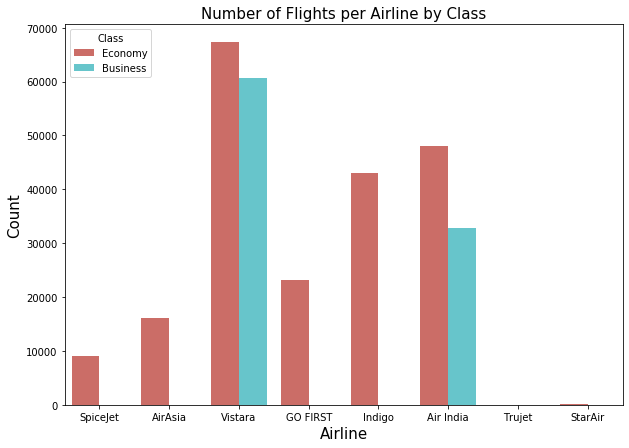

In [34]:
plt.figure(figsize=(10, 7))
sns.countplot(df['airline'], palette='hls' , hue=df['Class'])
plt.title('Number of Flights per Airline by Class', fontsize=15)
plt.xlabel('Airline',fontsize=15)
plt.ylabel('Count',fontsize=15)
plt.show()

In [35]:
#Departure_Time
departure_counts = df['departure_time'].value_counts()
departure_counts

Morning          88854
Evening          65416
Early-Morning    62042
night            49504
Afternoon        33253
late-Night        1190
Name: departure_time, dtype: int64

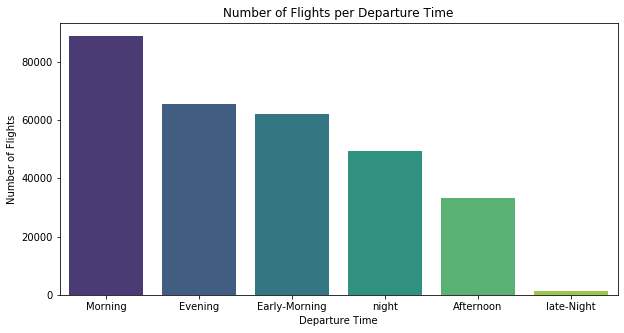

In [36]:
plt.figure(figsize=(10, 5))
sns.barplot(x=departure_counts.index, y=departure_counts.values, palette="viridis")
plt.title("Number of Flights per Departure Time")
plt.xlabel("Departure Time")
plt.ylabel("Number of Flights")
plt.show()

In [37]:
#From
from_counts = df['From'].value_counts()
from_counts

Delhi        61343
Mumbai       60903
Bangalore    52106
Kolkata      46347
Hyderabad    40860
Chennai      38700
Name: From, dtype: int64

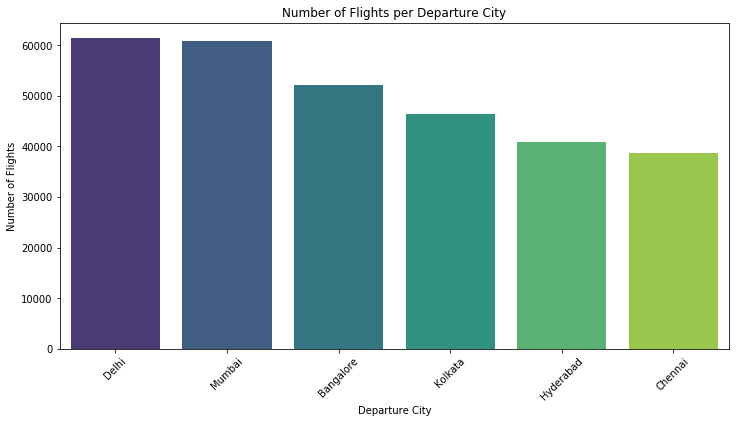

In [38]:
plt.figure(figsize=(12, 6))
sns.barplot(x=from_counts.index, y=from_counts.values, palette="viridis")
plt.xticks(rotation=45)
plt.title("Number of Flights per Departure City")
plt.xlabel("Departure City")
plt.ylabel("Number of Flights")
plt.show()

In [39]:
#Time Taken
print(df['time_taken'].describe())

count    300259.000000
mean        733.062340
std         431.575427
min          50.000000
25%         405.000000
50%         675.000000
75%         970.000000
max        2990.000000
Name: time_taken, dtype: float64


In [40]:
""""
(( IN HOURS ))
count    300259
mean        12 h
min         50 min
25%         6 h
50%         11 h
75%         16 h
max        49 h
"""

'"\n(( IN HOURS ))\ncount    300259\nmean        12 h\nmin         50 min\n25%         6 h\n50%         11 h\n75%         16 h\nmax        49 h\n'

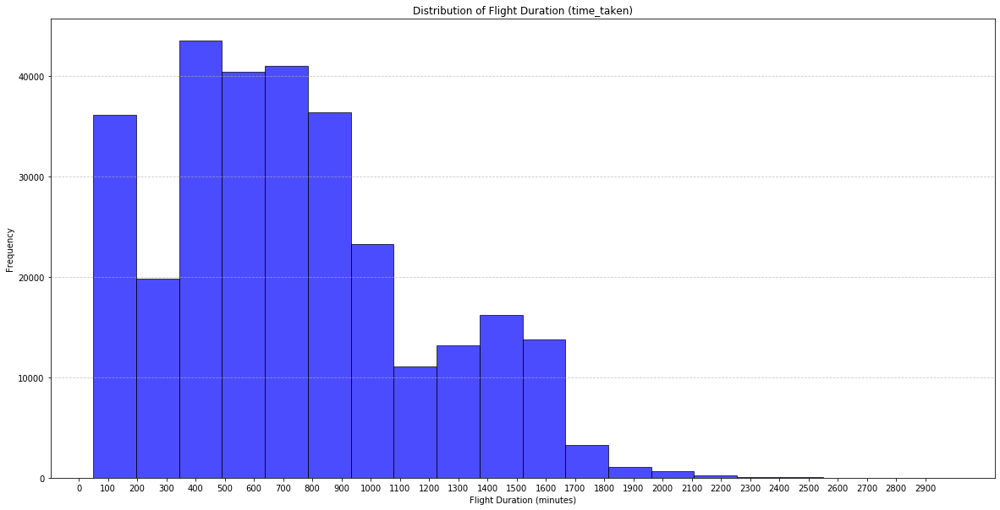

In [41]:
plt.figure(figsize=(20, 10))
plt.hist(df['time_taken'], bins=20, color="blue", edgecolor="black", alpha=0.7)
plt.title("Distribution of Flight Duration (time_taken)")
plt.xlabel("Flight Duration (minutes)")
plt.ylabel("Frequency")
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.xticks(np.arange(0,3000,100))
plt.show()

In [42]:
#stops 
stops_counts = df['stops'].value_counts()
stops_counts

One            250927
Zero            36044
Two or more     13288
Name: stops, dtype: int64

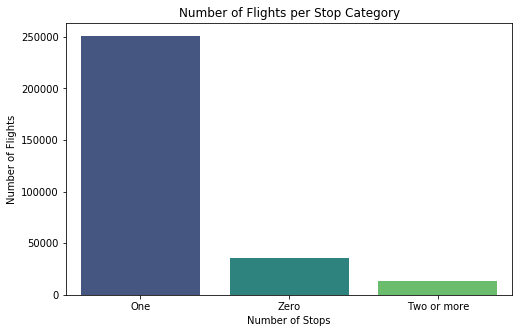

In [43]:
plt.figure(figsize=(8, 5))
sns.barplot(x=stops_counts.index, y=stops_counts.values, palette="viridis")
plt.title("Number of Flights per Stop Category")
plt.xlabel("Number of Stops")
plt.ylabel("Number of Flights")
plt.show()

In [44]:
fig = px.pie(
    names=stops_counts.index, 
    values=stops_counts,
    title="Percentage of Flights by Number of Stops",
    color_discrete_sequence=px.colors.sequential.Viridis
)
fig.show()

In [45]:
#Arrival Time
arrival_counts = df['arrival_time'].value_counts()
arrival_counts

night            93584
Morning          78998
Evening          77104
Afternoon        22691
late-Night       14001
Early-Morning    13881
Name: arrival_time, dtype: int64

In [46]:
fig = px.bar(
    x=arrival_counts.index, 
    y=arrival_counts.values,
    title="Number of Flights per Arrival Time",
    labels={"x": "Arrival Time", "y": "Number of Flights"},
    color=arrival_counts.values,
    color_continuous_scale=px.colors.sequential.Plasma[::-1]
)

fig.show()

In [47]:
#to
to_counts = df['to'].value_counts()
to_counts

Mumbai       59107
Delhi        57361
Bangalore    51112
Kolkata      49535
Hyderabad    42776
Chennai      40368
Name: to, dtype: int64

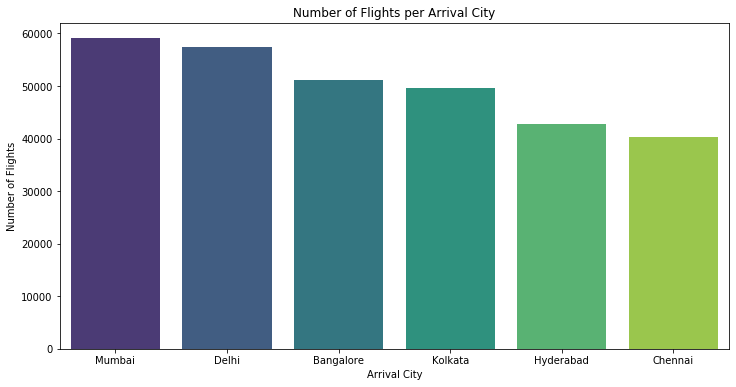

In [48]:
plt.figure(figsize=(12, 6))
sns.barplot(x=to_counts.index, y=to_counts.values, palette="viridis")
plt.title("Number of Flights per Arrival City")
plt.xlabel("Arrival City")
plt.ylabel("Number of Flights")
plt.show()

In [49]:
#price
print(df['price'].describe())

count    300259.000000
mean      20845.940408
std       22642.572754
min         100.000000
25%        4783.000000
50%        7425.000000
75%       42457.000000
max       99680.000000
Name: price, dtype: float64


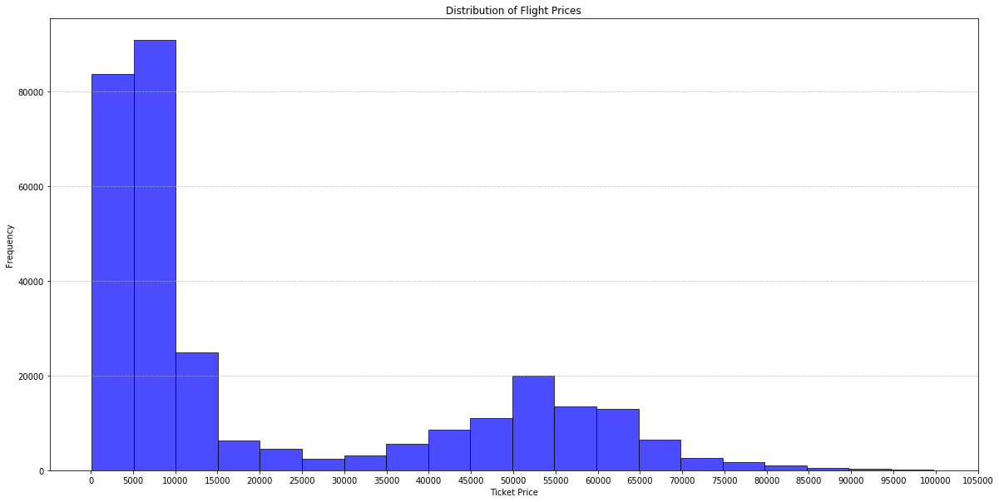

In [50]:
plt.figure(figsize=(20, 10))
plt.hist(df['price'], bins=20, color="blue", edgecolor="black", alpha=0.7)
plt.title("Distribution of Flight Prices")
plt.xlabel("Ticket Price")
plt.ylabel("Frequency")
plt.xticks(np.arange(0, df['price'].max()+10000, 5000))
plt.grid(axis="y", linestyle="--", alpha=0.7)
plt.show()

In [51]:
# Performance Comparison: Average Price vs. Number of Flights by Airline
company_comparison = df.groupby('airline').agg({'price': 'mean', 'airline': 'count'}).rename(columns={'airline': 'flight_count'}).reset_index()
px.scatter(company_comparison, x='price', y='flight_count', size='flight_count', color='airline',
                  title='Comparison of Average Price vs. Number of Flights by Airline',
                  labels={'price': 'Average Price (INR)', 'flight_count': 'Number of Flights'})

In [52]:
#Class
class_count = df['Class'].value_counts()
class_count

Economy     206772
Business     93487
Name: Class, dtype: int64

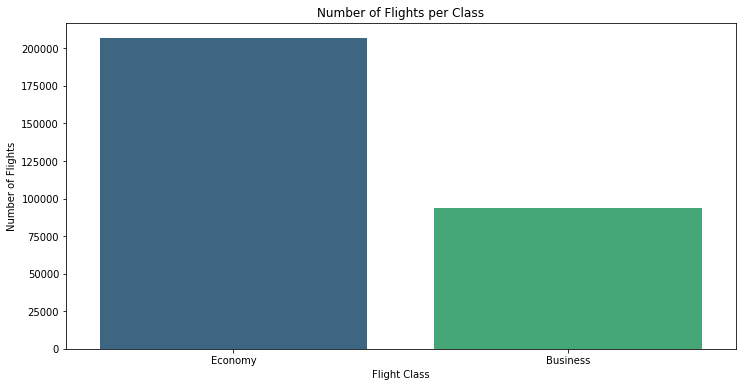

In [53]:
plt.figure(figsize=(12, 6))
sns.barplot(x=class_count.index, y=class_count.values, palette="viridis")
plt.title("Number of Flights per Class")
plt.xlabel("Flight Class")
plt.ylabel("Number of Flights")
plt.show()

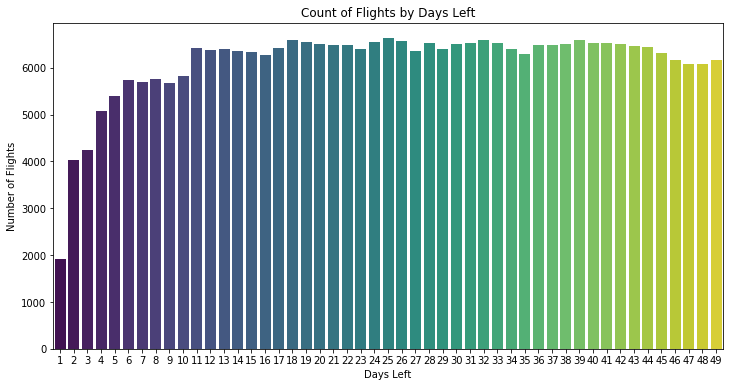

In [54]:
#Days left
plt.figure(figsize=(12, 6))
sns.countplot(x=df['days_left'], palette="viridis")
plt.title("Count of Flights by Days Left")
plt.xlabel("Days Left")
plt.ylabel("Number of Flights")
plt.show()

In [55]:
df['days_left'].describe()

count    300259.000000
mean         26.004529
std          13.560967
min           1.000000
25%          15.000000
50%          26.000000
75%          38.000000
max          49.000000
Name: days_left, dtype: float64

##### 4.2 ) Bivariate & Multivariate Analysis

In [56]:
e_df = df[df['Class'] == "Economy"]
b_df = df[df['Class']=="Business"]

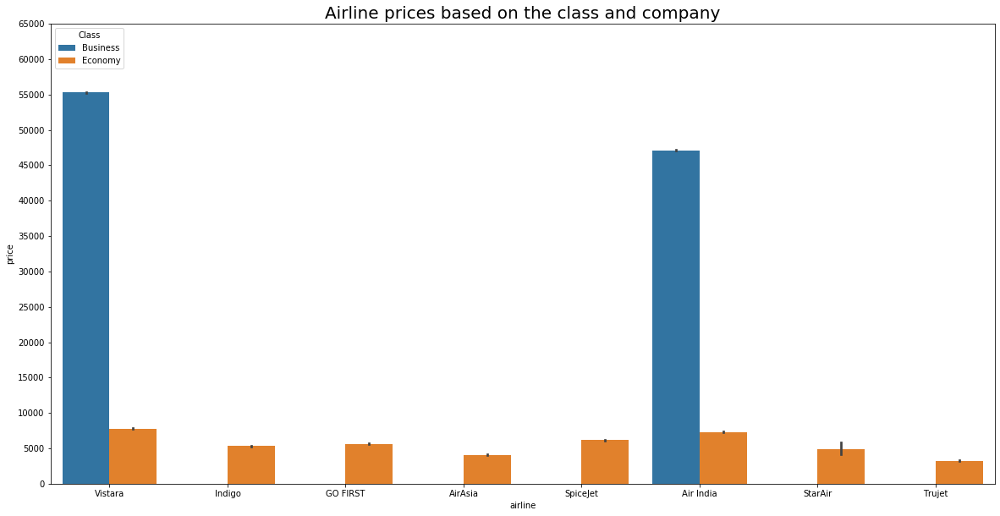

In [57]:
plt.figure(figsize=(20, 10))
sns.barplot(x='airline',y='price',hue="Class",data=df.sort_values("price")).set_title('Airline prices based on the class and company',fontsize=20)
plt.yticks(np.arange(0,70000,5000))
plt.show()

In [58]:
# Minimum, Maximum, and Average Prices for Each Airline
price_range = df.groupby('airline')['price'].agg(['min', 'max', 'mean']).reset_index()
market_avg = df['price'].mean()
px.bar(price_range, x='airline', y=['min', 'max', 'mean'], barmode='group',
              title=f'Min, Max, and Average Prices by Airline (Overall Avg: {market_avg:.2f} INR)',
              labels={'value': 'Price (INR)', 'variable': 'Type'})

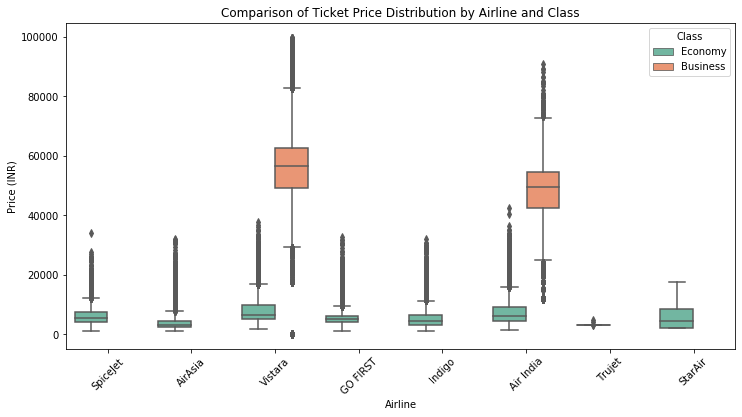

In [59]:
plt.figure(figsize=(12, 6))
sns.boxplot(x='airline', y='price', hue='Class', data=df, palette='Set2')

plt.xticks(rotation=45)
plt.title('Comparison of Ticket Price Distribution by Airline and Class')
plt.xlabel('Airline')
plt.ylabel('Price (INR)')
plt.legend(title='Class')  
plt.show()


In [60]:
# Price Volatility for Each Airline (Standard Deviation)
price_volatility = df.groupby('airline')['price'].std().reset_index()
px.bar(price_volatility, x='airline', y='price', 
              title='Price Volatility by Airline (Standard Deviation)',
              labels={'price': 'Price Standard Deviation'})

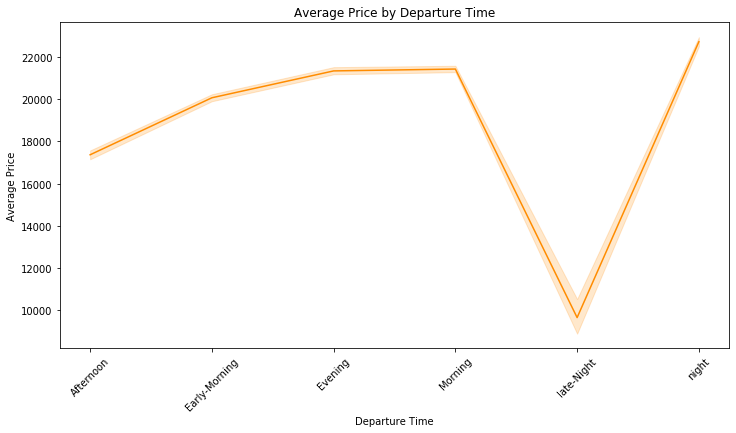

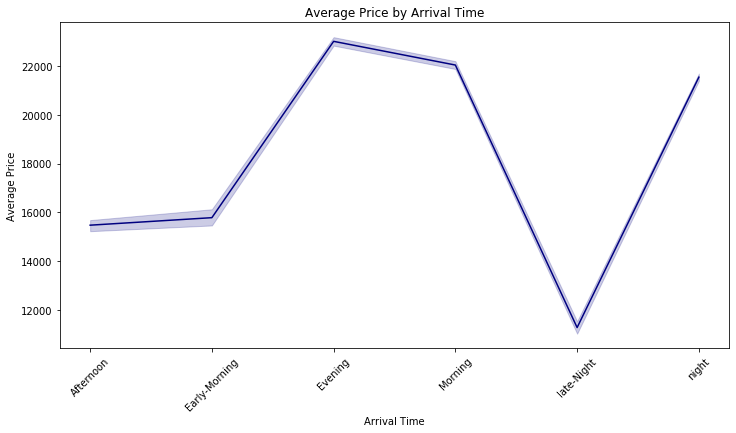

In [61]:
# Analysis of Average Ticket Prices Based on Departure and Arrival Times
plt.figure(figsize=(12, 6))
sns.lineplot(x="departure_time", y="price", data=df, estimator="mean",color='darkorange' )
plt.title("Average Price by Departure Time")
plt.xlabel("Departure Time")
plt.ylabel("Average Price")
plt.xticks(rotation=45)


plt.figure(figsize=(12, 6))
sns.lineplot(x="arrival_time", y="price", data=df, estimator="mean",color='navy' )
plt.title("Average Price by Arrival Time")
plt.xlabel("Arrival Time")
plt.ylabel("Average Price")
plt.xticks(rotation=45)
plt.show()

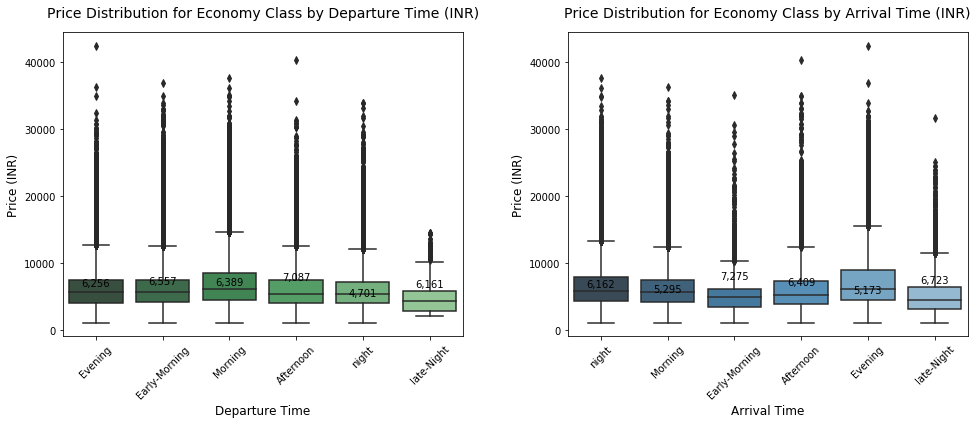

In [63]:
# Price Distribution for Economy Class by Departure and Arrival Time

# Filter only Economy Class data

fig, ax = plt.subplots(1, 2, figsize=(14, 6))  

# ---- Boxplot for Departure Time ----
sns.boxplot(x='departure_time', y='price', data=e_df, palette='Greens_d', ax=ax[0])
ax[0].set_title('Price Distribution for Economy Class by Departure Time (INR)', fontsize=14, pad=15)
ax[0].set_xlabel('Departure Time', fontsize=12)
ax[0].set_ylabel('Price (INR)', fontsize=12)
ax[0].tick_params(axis='x', rotation=45)

# Adding mean values for each departure time
mean_departure = e_df.groupby('departure_time')['price'].mean()
for i, mean_val in enumerate(mean_departure):
    ax[0].text(i, mean_val, f'{int(mean_val):,}', ha='center', va='bottom', fontsize=10)

# ---- Boxplot for Arrival Time ----
sns.boxplot(x='arrival_time', y='price', data=e_df, palette='Blues_d', ax=ax[1])
ax[1].set_title('Price Distribution for Economy Class by Arrival Time (INR)', fontsize=14, pad=15)
ax[1].set_xlabel('Arrival Time', fontsize=12)
ax[1].set_ylabel('Price (INR)', fontsize=12)
ax[1].tick_params(axis='x', rotation=45)

# Adding mean values for each arrival time
mean_arrival = e_df.groupby('arrival_time')['price'].mean()
for i, mean_val in enumerate(mean_arrival):
    ax[1].text(i, mean_val, f'{int(mean_val):,}', ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()

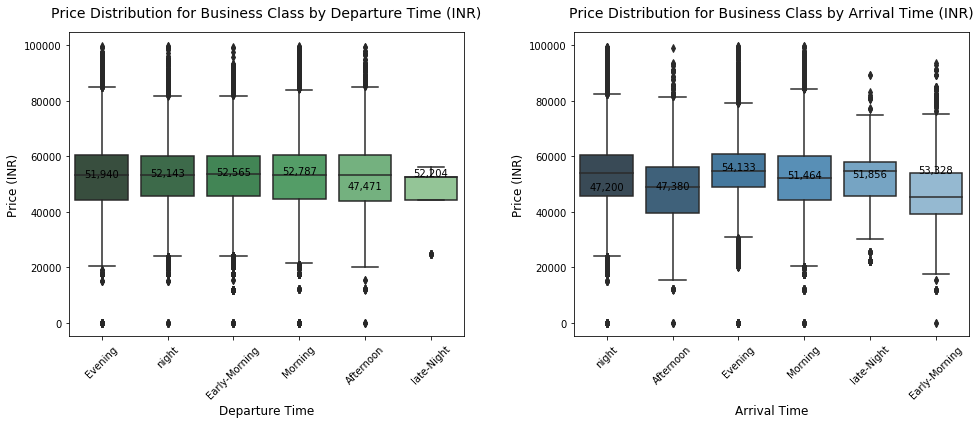

In [64]:
# Price Distribution for Business Class by Departure and Arrival Time

fig, ax = plt.subplots(1, 2, figsize=(14, 6))  

# ---- Boxplot for Departure Time ----
sns.boxplot(x='departure_time', y='price', data=b_df, palette='Greens_d', ax=ax[0])
ax[0].set_title('Price Distribution for Business Class by Departure Time (INR)', fontsize=14, pad=15)
ax[0].set_xlabel('Departure Time', fontsize=12)
ax[0].set_ylabel('Price (INR)', fontsize=12)
ax[0].tick_params(axis='x', rotation=45)

# Adding mean values for each departure time
mean_departure = b_df.groupby('departure_time')['price'].mean()
for i, mean_val in enumerate(mean_departure):
    ax[0].text(i, mean_val, f'{int(mean_val):,}', ha='center', va='bottom', fontsize=10)

# ---- Boxplot for Arrival Time ----
sns.boxplot(x='arrival_time', y='price', data=b_df, palette='Blues_d', ax=ax[1])
ax[1].set_title('Price Distribution for Business Class by Arrival Time (INR)', fontsize=14, pad=15)
ax[1].set_xlabel('Arrival Time', fontsize=12)
ax[1].set_ylabel('Price (INR)', fontsize=12)
ax[1].tick_params(axis='x', rotation=45)

# Adding mean values for each arrival time
mean_arrival = b_df.groupby('arrival_time')['price'].mean()
for i, mean_val in enumerate(mean_arrival):
    ax[1].text(i, mean_val, f'{int(mean_val):,}', ha='center', va='bottom', fontsize=10)

plt.tight_layout()
plt.show()


In [65]:
# Count the number of flights for each route (from → to)  
df.groupby(['From', 'to']).size().reset_index(name='Number of Flights')

,From,to,Number of Flights
0,Bangalore,Chennai,6410
1,Bangalore,Delhi,13756
2,Bangalore,Hyderabad,8971
3,Bangalore,Kolkata,10029
4,Bangalore,Mumbai,12940
5,Chennai,Bangalore,6493
6,Chennai,Delhi,9783
7,Chennai,Hyderabad,6103
8,Chennai,Kolkata,6983
9,Chennai,Mumbai,9338


In [66]:
# Get the top 10 routes with the highest number of flights  
df.groupby(['From', 'to']).size().reset_index(name='Number of Flights').nlargest(10, 'Number of Flights')

,From,to,Number of Flights
14,Delhi,Mumbai,15289
27,Mumbai,Delhi,14809
10,Delhi,Bangalore,14012
1,Bangalore,Delhi,13756
4,Bangalore,Mumbai,12940
25,Mumbai,Bangalore,12885
29,Mumbai,Kolkata,12602
13,Delhi,Kolkata,11934
24,Kolkata,Mumbai,11467
11,Delhi,Chennai,10780


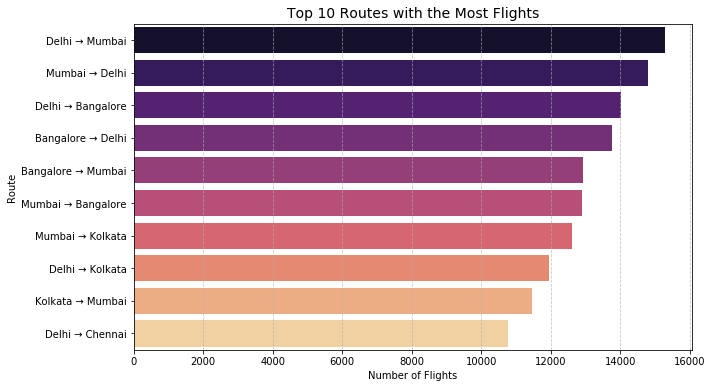

In [67]:
top_routes = df.groupby(['From', 'to']).size().reset_index(name='Number of Flights').nlargest(10, 'Number of Flights')

plt.figure(figsize=(10, 6))
sns.barplot(x='Number of Flights', y=top_routes['From'] + " → " + top_routes['to'], data=top_routes, palette="magma")

plt.title("Top 10 Routes with the Most Flights", fontsize=14)
plt.xlabel("Number of Flights")
plt.ylabel("Route")
plt.grid(axis="x", linestyle="--", alpha=0.7)
plt.show()

In [68]:
# Grouping by route and calculating mean, max, and min ticket prices(for Economy Tickets)
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    result = e_df.groupby(['From', 'to', 'airline']).agg(
        Mean=('price', np.mean),
        Max=('price', np.max),
        Min=('price', np.min)
    ).round(2)
    
    display(result)

Mean    Max   Min
From      to        airline                         
Bangalore Chennai   Air India   8219.48  28174  1966
                    AirAsia     2073.04   4285  1603
                    GO FIRST    5351.95  12920  3091
                    Indigo      2363.33   9693  1604
                    SpiceJet    2613.31   6017  1606
                    Vistara     7911.96  25917  4672
          Delhi     Air India   6787.89  24604  3674
                    AirAsia     4807.09  22471  2723
                    GO FIRST    5524.70  30284  3319
                    Indigo      6273.50  23816  3236
                    SpiceJet    6901.62  34158  3101
                    Vistara     6505.51  29119  3346
          Hyderabad Air India   8107.72  27610  1966
                    AirAsia     2931.49  11205  1714
                    GO FIRST    4827.18  13498  1714
                    Indigo      3220.66  12003  1694
                    SpiceJet    4338.00   4338  4338
                    StarAir     5933.12  17482  2000
                    Trujet      3289.00   3289  3289
                    Vistara     7607.46  25654  1714
          Kolkata   Air India   8662.25  22819  3393
                    AirAsia     4443.47  25993  3185
                    GO FIRST    5793.46  27620  3393
                    Indigo      6230.33  29213  3026
                    SpiceJet    5297.97  25024  3393
                    Vistara     9670.00  29382  6271
          Mumbai    Air India   7342.07  40354  2208
                    AirAsia     3342.39  15022  2201
                    GO FIRST    5533.53  24809  2201
                    Indigo      5112.27  24971  2201
                    SpiceJet    6058.64  16728  2202
                    Vistara     7691.23  28836  2150
Chennai   Bangalore Air India   8859.25  36333  1830
                    AirAsia     1914.76   9557  1443
                    GO FIRST    5643.07  15289  2212
                    Indigo      2845.48  13127  1443
                    SpiceJet    2426.31   3361  1444
                    Vistara     7895.91  36911  4536
          Delhi     Air India   6540.97  32911  2271
                    AirAsia     3697.31  20267  2477
                    GO FIRST    4994.12   7859  2712
                    Indigo      5250.70  24047  2051
                    SpiceJet    5875.29  20058  2516
                    Vistara     7651.80  34968  2051
          Hyderabad Air India   7516.31  26148  1526
                    AirAsia     2053.18  11867  1105
                    GO FIRST    1613.11   4933  1105
                    Indigo      3641.29  11972  1105
                    SpiceJet    3291.73   7615  1106
                    Vistara     7721.58  22998  3810
          Kolkata   Air India   8052.79  42349  2360
                    AirAsia     3682.34  21364  2359
                    GO FIRST    7926.34  12779  2998
                    Indigo      5667.82  23575  2359
                    SpiceJet    4672.56  20478  2359
                    Vistara     9902.88  32658  5660
          Mumbai    Air India   7064.80  34982  1830
                    AirAsia     2691.10  11783  1830
                    GO FIRST    4205.20  11104  3000
                    Indigo      5014.56  23312  1830
                    SpiceJet    5474.07  16908  2955
                    Vistara     7898.55  37646  2840
Delhi     Bangalore Air India   6929.02  28005  3610
                    AirAsia     5316.40  31917  3090
                    GO FIRST    5660.52  30222  3568
                    Indigo      6084.36  24120  3127
                    SpiceJet    6679.89  24489  3133
                    Vistara     6385.01  30840  3229
          Chennai   Air India   6540.42  35145  2343
                    AirAsia     3393.98  22546  1998
                    GO FIRST    5085.22   7933  2968
                    Indigo      5164.76  19626  2050
                    SpiceJet    6002.37  25454  2637
                    Vistara     7859.25  27270  2049
       

In [69]:
# Finds the airline with the lowest average Business ticket price for each route
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    result = b_df.groupby(['From', 'to', 'airline']).agg(
        Mean=('price', np.mean)).round(2)

    # Selecting the airline with the lowest average Business ticket price per route
    min_price_routes = result.loc[result.groupby(['From', 'to'])['Mean'].idxmin()]

    display(min_price_routes.reset_index())

,From,to,airline,Mean
0,Bangalore,Chennai,Vistara,51001.40
1,Bangalore,Delhi,Air India,40608.95
2,Bangalore,Hyderabad,Vistara,50120.35
3,Bangalore,Kolkata,Air India,55836.15
4,Bangalore,Mumbai,Air India,51648.61
5,Chennai,Bangalore,Vistara,51566.17
6,Chennai,Delhi,Air India,42005.11
7,Chennai,Hyderabad,Air India,50870.05
8,Chennai,Kolkata,Air India,54365.96
9,Chennai,Mumbai,Air India,48780.45


In [70]:
# Finds the airline with the lowest average price for each route
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    result = e_df.groupby(['From', 'to', 'airline']).agg(Mean=('price', np.mean)).round(2)

    # Selecting the airline with the lowest average Economy ticket price per route
    min_price_routes = result.loc[result.groupby(['From', 'to'])['Mean'].idxmin()]

    display(min_price_routes.reset_index())

,From,to,airline,Mean
0,Bangalore,Chennai,AirAsia,2073.04
1,Bangalore,Delhi,AirAsia,4807.09
2,Bangalore,Hyderabad,AirAsia,2931.49
3,Bangalore,Kolkata,AirAsia,4443.47
4,Bangalore,Mumbai,AirAsia,3342.39
5,Chennai,Bangalore,AirAsia,1914.76
6,Chennai,Delhi,AirAsia,3697.31
7,Chennai,Hyderabad,GO FIRST,1613.11
8,Chennai,Kolkata,AirAsia,3682.34
9,Chennai,Mumbai,AirAsia,2691.10


In [71]:
# Grouping by route and calculating mean, max, and min ticket prices(for Business Tickets)
b_df.groupby(['From', 'to' , 'airline']).agg(
    Mean=('price', np.mean),
    Max=('price', np.max),
    Min=('price', np.min)
).round(2)

Mean    Max    Min
From      to        airline                          
Bangalore Chennai   Air India  56301.93  88030  12136
                    Vistara    51001.40  90720  44280
          Delhi     Air India  40608.95  64158  32923
                    Vistara    51110.09  91689    111
          Hyderabad Air India  51169.90  61212  12000
                    Vistara    50120.35  83239  37985
          Kolkata   Air India  55836.15  62748  25000
                    Vistara    59979.40  98919    105
          Mumbai    Air India  51648.61  75953  20760
                    Vistara    61376.79  99680    101
Chennai   Bangalore Air India  56733.85  89257  12000
                    Vistara    51566.17  98839    107
          Delhi     Air India  42005.11  62789  27792
                    Vistara    56150.86  94504    103
          Hyderabad Air India  50870.05  80342  15000
                    Vistara    51867.36  92752  41064
          Kolkata   Air India  54365.96  84374  20000
                    Vistara    58543.38  96224    102
          Mumbai    Air India  48780.45  86491  23424
                    Vistara    60363.27  99584    101
Delhi     Bangalore Air India  41222.32  64094  32859
                    Vistara    51931.71  85353  32859
          Chennai   Air India  43908.95  79741  27864
                    Vistara    56560.22  99577    100
          Hyderabad Air India  39139.17  60590  23944
                    Vistara    47807.75  96587    104
          Kolkata   Air India  45732.96  83460  27976
                    Vistara    62598.45  99129    100
          Mumbai    Air India  41907.87  68038  22152
                    Vistara    46384.87  95657  22152
Hyderabad Bangalore Air India  51507.93  64407  12114
                    Vistara    49939.71  97767  38099
          Chennai   Air India  49649.86  80762  15250
                    Vistara    51912.69  95208  41314
          Delhi     Air India  39074.97  57141  24122
                    Vistara    47483.84  86203  24234
          Kolkata   Air India  48849.18  59524  20000
                    Vistara    56485.59  97381  48851
          Mumbai    Air India  44073.87  67827  17738
                    Vistara    56508.80  96205    100
Kolkata   Bangalore Air India  56069.90  69938  25470
                    Vistara    59436.32  99389    105
          Chennai   Air India  54896.04  80756  20606
                    Vistara    57689.29  95183  55502
          Delhi     Air India  46276.11  77076  28510
                    Vistara    61117.18  98543    100
          Hyderabad Air India  49589.83  75382  20356
                    Vistara    56720.68  98465    101
          Mumbai    Air India  48512.36  71540  31838
                    Vistara    62683.55  99551    104
Mumbai    Bangalore Air India  51925.70  76997  20684
                    Vistara    60598.23  99403    100
          Chennai   Air India  48040.25  90970  23484
                    Vistara    59625.30  98972    100
          Delhi     Air India  40804.09  79954  22140
                    Vistara    46033.76  90308    111
          Hyderabad Air India  43629.74  60537  17548
                    Vistara    55570.45  99677  17604
          Kolkata   Air India  47907.27  67200  31292
                    Vistara    62483.42  98904    100

In [72]:
# Mean Flight Duration for Each Route and Airline
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    result = df.groupby(['From', 'to', 'airline']).agg(
        Mean_Duration=('time_taken', np.mean),  # Renamed to Mean_Duration for clarity
    ).round(2)
    
    display(result)

Mean_Duration
From      to        airline                 
Bangalore Chennai   Air India        1021.77
                    AirAsia            62.32
                    GO FIRST          630.99
                    Indigo             62.45
                    SpiceJet           65.00
                    Vistara           926.16
          Delhi     Air India         781.24
                    AirAsia           484.95
                    GO FIRST          448.81
                    Indigo            365.96
                    SpiceJet          791.08
                    Vistara           610.58
          Hyderabad Air India        1033.57
                    AirAsia           217.19
                    GO FIRST          561.59
                    Indigo            300.64
                    SpiceJet           62.90
                    StarAir           182.50
                    Trujet            145.00
                    Vistara           976.86
          Kolkata   Air India        1016.26
                    AirAsia           453.46
                    GO FIRST          632.47
                    Indigo            413.37
                    SpiceJet          533.69
                    Vistara           929.59
          Mumbai    Air India         875.07
                    AirAsia           498.90
                    GO FIRST          586.14
                    Indigo            306.65
                    SpiceJet          793.31
                    Vistara           661.02
Chennai   Bangalore Air India        1039.73
                    AirAsia            70.40
                    GO FIRST          546.03
                    Indigo            167.16
                    SpiceJet           80.00
                    Vistara           877.86
          Delhi     Air India         742.25
                    AirAsia           717.79
                    GO FIRST          607.13
                    Indigo            391.83
                    SpiceJet          945.97
                    Vistara           702.39
          Hyderabad Air India         879.08
                    AirAsia           407.98
                    GO FIRST           83.03
                    Indigo            318.81
                    SpiceJet          421.67
                    Vistara           994.09
          Kolkata   Air India        1072.06
                    AirAsia           378.63
                    GO FIRST          595.90
                    Indigo            431.07
                    SpiceJet          597.14
                    Vistara          1054.06
          Mumbai    Air India        1010.35
                    AirAsia           524.73
                    GO FIRST          364.88
                    Indigo            363.38
                    SpiceJet          436.32
                    Vistara           733.70
Delhi     Bangalore Air India         904.82
                    AirAsia           507.62
                    GO FIRST          430.19
                    Indigo            394.31
                    SpiceJet          783.96
                    Vistara           607.84
          Chennai   Air India        1004.69
                    AirAsia           666.15
                    GO FIRST          566.54
                    Indigo            400.29
                    SpiceJet          908.81
                    Vistara           753.38
          Hyderabad Air India         949.57
                    AirAsia           551.49
                    GO FIRST          461.70
                    Indigo            335.58
                    SpiceJet          324.21
                    Vistara           803.81
          Kolkata   Air India         970.24
                    AirAsia           571.35
                    GO FIRST          622.72
                    Indigo            307.43
                    SpiceJet          712.77
                    Vistara           885.95
          Mumbai    Air India         819.77
                    AirAsi

In [73]:
# Finds the airline with the lowest average flight duration for each route
with pd.option_context('display.max_rows', None, 'display.max_columns', None):
    result = df.groupby(['From', 'to', 'airline']).agg(
        Mean=('time_taken', np.mean),
    ).round(2)
    min_time_routes = result.loc[result.groupby(['From', 'to'])['Mean'].idxmin()]
    display(min_time_routes.reset_index())

,From,to,airline,Mean
0,Bangalore,Chennai,AirAsia,62.32
1,Bangalore,Delhi,Indigo,365.96
2,Bangalore,Hyderabad,SpiceJet,62.90
3,Bangalore,Kolkata,Indigo,413.37
4,Bangalore,Mumbai,Indigo,306.65
5,Chennai,Bangalore,AirAsia,70.40
6,Chennai,Delhi,Indigo,391.83
7,Chennai,Hyderabad,GO FIRST,83.03
8,Chennai,Kolkata,AirAsia,378.63
9,Chennai,Mumbai,Indigo,363.38


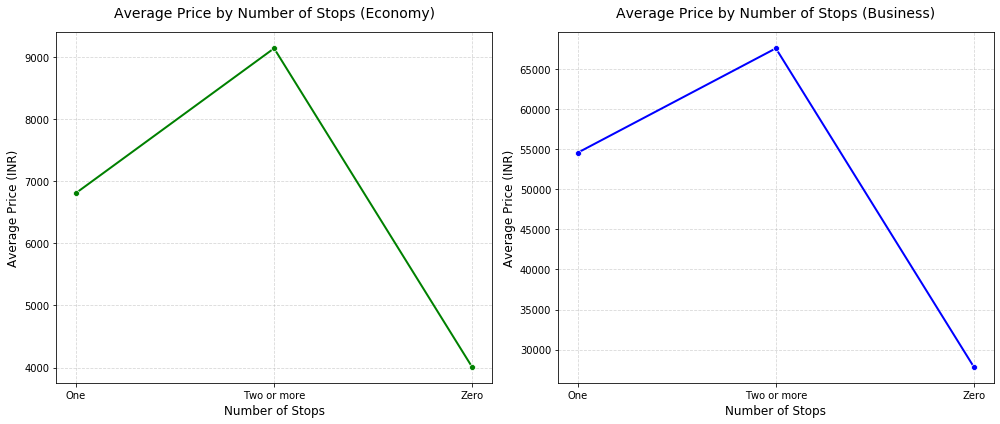

In [74]:
fig, ax = plt.subplots(1, 2, figsize=(14, 6))

# ---- Economy Class ----
avg_price_economy = e_df.groupby('stops')['price'].mean()
sns.lineplot(x=avg_price_economy.index, y=avg_price_economy.values, marker='o', color='g', linewidth=2, ax=ax[0])
ax[0].set_title("Average Price by Number of Stops (Economy)", fontsize=14, pad=15)
ax[0].set_xlabel("Number of Stops", fontsize=12)
ax[0].set_ylabel("Average Price (INR)", fontsize=12)
ax[0].grid(True, linestyle='--', alpha=0.5)

# ---- Business Class ----
avg_price_business = b_df.groupby('stops')['price'].mean()
sns.lineplot(x=avg_price_business.index, y=avg_price_business.values, marker='o', color='b', linewidth=2, ax=ax[1])
ax[1].set_title("Average Price by Number of Stops (Business)", fontsize=14, pad=15)
ax[1].set_xlabel("Number of Stops", fontsize=12)
ax[1].set_ylabel("Average Price (INR)", fontsize=12)
ax[1].grid(True, linestyle='--', alpha=0.5)

plt.tight_layout()
plt.show()


Text(0.5, 1.0, 'Airline prices based on the number of stops for class business')

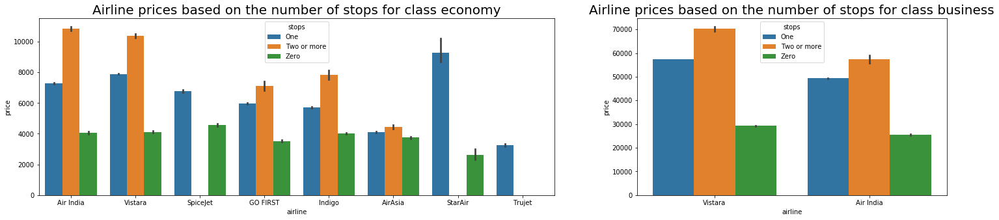

In [75]:
fig, axs = plt.subplots (1, 2, gridspec_kw={'width_ratios': [5, 3]}, figsize=(25, 5))
sns.barplot(y = "price", x = "airline", hue="stops", data = df.loc[df["Class"]=='Economy'].sort_values("price", ascending = False), ax=axs[0])
axs[0].set_title("Airline prices based on the number of stops for class economy",fontsize=20)

sns.barplot(y = "price", x = "airline", hue="stops", data = df.loc[df["Class"]=='Business'].sort_values("price", ascending = False), ax=axs[1])
axs[1].set_title("Airline prices based on the number of stops for class business",fontsize=20)

In [76]:
fig = px.scatter(
    df, 
    x='time_taken', 
    y='price', 
    color='airline', 
    size='time_taken', 
    facet_col='stops',
    title='Price vs. Time Taken by Airline and Number of Stops',
    labels={'time_taken': 'Time Taken (Minutes)', 'price': 'Price (INR)'},
    size_max=20,
    opacity=0.7, 
    color_discrete_sequence=px.colors.qualitative.Set1
)

buttons = [
    {"label": "All Airlines", "method": "update", "args": [{"visible": [True] * len(fig.data)}]}
]

airlines = df['airline'].unique()
for airline in airlines:
    visibility = [trace.name == airline for trace in fig.data]
    buttons.append({"label": airline, "method": "update", "args": [{"visible": visibility}]})

fig.update_layout(
    height=600,
    margin=dict(t=150),
    title=dict(font_size=18, y=0.98),
    updatemenus=[
        {
            "buttons": buttons,
            "direction": "down",
            "showactive": True,
            "x": 0.05,
            "y": 1.1
        }
    ]
)

fig.show()

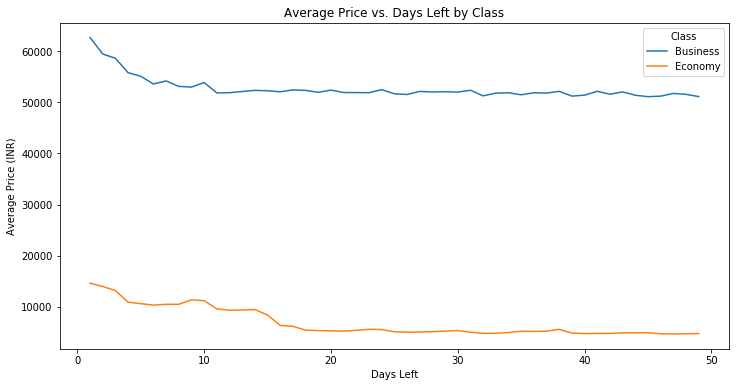

In [77]:
# Average Flight Price Based on Days Left Until Departure by Class
pivot_data = df.pivot_table(values='price', index='days_left', columns='Class', aggfunc='mean')
pivot_data.plot(figsize=(12, 6))
plt.title('Average Price vs. Days Left by Class')
plt.xlabel('Days Left')
plt.ylabel('Average Price (INR)')
plt.show()

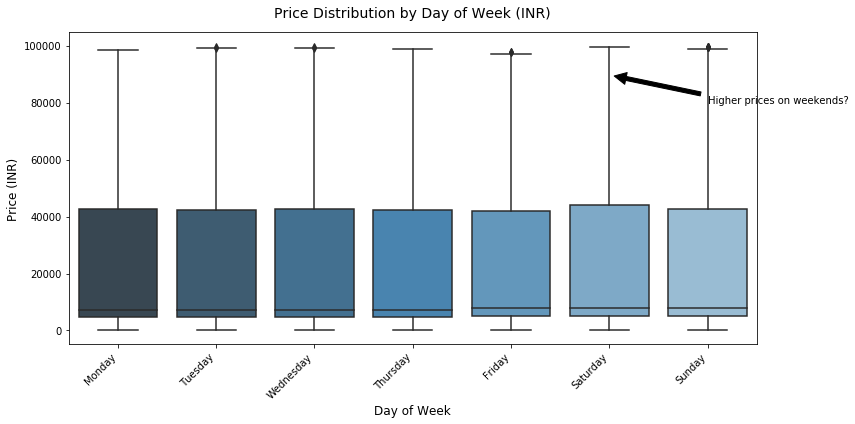

In [78]:
#  Analyzing Flight Price Trends by Day of the Week
plt.figure(figsize=(12, 6))
sns.boxplot(x='day_of_week', y='price', data=df, 
            order=['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday'],
            palette='Blues_d')
plt.title('Price Distribution by Day of Week (INR)', fontsize=14, pad=15)
plt.xlabel('Day of Week', fontsize=12)
plt.ylabel('Price (INR)', fontsize=12)
plt.xticks(rotation=45, ha='right')


plt.annotate('Higher prices on weekends?', xy=(5, df['price'].max()*0.9), xytext=(6, df['price'].max()*0.8),
             arrowprops=dict(facecolor='black', shrink=0.05), fontsize=10)

plt.tight_layout()
plt.show()

In [79]:
# Heatmap of Average Prices by Day of the Week
heatmap_data = df.groupby('day_of_week')['price'].mean().reindex(
    ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']).reset_index()

px.imshow([heatmap_data['price']], x=heatmap_data['day_of_week'], y=['Price'],
                 title='Average Price Heatmap by Day of the Week', 
                 color_continuous_scale=px.colors.sequential.Viridis[::-1])

In [80]:
departure_dropdown = widgets.Dropdown(
    options=df['From'].unique(),
    description='مدينة المغادرة:'
)

arrival_dropdown = widgets.Dropdown(
    options=df['to'].unique(),
    description='الوجهة:'
)

class_dropdown = widgets.Dropdown(
    options=df['Class'].unique(),  
    description='الدرجة:'
)

def update_plots(departure, arrival, flight_class):
    filtered_df = df[(df['From'] == departure) & (df['to'] == arrival) & (df['Class'] == flight_class)]
    
    if filtered_df.empty:
        print(f"⚠ لا توجد رحلات متاحة لهذا المسار بدرجة {flight_class}!")
        return
    
    company_comparison = filtered_df.groupby('airline').agg({'price': 'mean', 'airline': 'count'}).rename(columns={'airline': 'flight_count'}).reset_index()
    fig1 = px.scatter(company_comparison, x='price', y='flight_count', size='flight_count', color='airline',
                      title='مقارنة الأداء: متوسط السعر مقابل عدد الرحلات',
                      labels={'price': 'متوسط السعر', 'flight_count': 'عدد الرحلات'})
    fig1.show()
    
    price_volatility = filtered_df.groupby('airline')['price'].std().reset_index()
    fig2 = px.bar(price_volatility, x='airline', y='price', 
                  title='تقلبات الأسعار لكل شركة (الانحراف المعياري)',
                  labels={'price': 'الانحراف المعياري للسعر'})
    fig2.show()
    
    market_share = filtered_df['airline'].value_counts().reset_index()
    market_share.columns = ['airline', 'flight_count']
    fig3 = px.pie(market_share, names='airline', values='flight_count', 
                  title='حصة السوق حسب الشركة')
    fig3.show()
    
    price_range = filtered_df.groupby('airline')['price'].agg(['min', 'max', 'mean']).reset_index()
    market_avg = filtered_df['price'].mean()
    fig4 = px.bar(price_range, x='airline', y=['min', 'max', 'mean'], barmode='group',
                  title=f'الحد الأدنى والأقصى والمتوسط للأسعار (المتوسط العام: {market_avg:.2f})',
                  labels={'value': 'السعر', 'variable': 'النوع'})
    fig4.show()
    
    if 'date' in filtered_df.columns:
        filtered_df['date'] = pd.to_datetime(filtered_df['date'])
        filtered_df['day_of_week'] = filtered_df['date'].dt.day_name()
        heatmap_data = filtered_df.groupby('day_of_week')['price'].mean().reindex(
            ['Monday', 'Tuesday', 'Wednesday', 'Thursday', 'Friday', 'Saturday', 'Sunday']).reset_index()
        fig5 = px.imshow([heatmap_data['price']], x=heatmap_data['day_of_week'], y=['السعر'],
                         title='خريطة حرارية لمتوسط الأسعار حسب يوم الأسبوع', 
                         color_continuous_scale='Viridis')
        fig5.show()
    else:
        print("⚠ عمود 'date' غير موجود في البيانات.")

# ربط الواجهة التفاعلية مع الدوال والقوائم المنسدلة
interact(
    update_plots,
    departure=departure_dropdown,
    arrival=arrival_dropdown,
    flight_class=class_dropdown
)

interactive(children=(Dropdown(description='مدينة المغادرة:', options=('Delhi', 'Mumbai', 'Bangalore', 'Kolkat…

<function __main__.update_plots(departure, arrival, flight_class)>

In [81]:
departure_dropdown = widgets.Dropdown(
    options=df['From'].unique(),
    description='مدينة المغادرة:'
)

arrival_dropdown = widgets.Dropdown(
    options=df['to'].unique(),
    description='الوجهة:'
)

class_dropdown = widgets.Dropdown(
    options=df['Class'].unique(),  
    description='الدرجة:'
)

def update_plots(departure, arrival, flight_class):
    filtered_df = df[(df['From'] == departure) & (df['to'] == arrival) & (df['Class'] == flight_class)]  # تغيير 'class' إلى 'Class'
    
    if filtered_df.empty:
        print(f"⚠ لا توجد رحلات متاحة لهذا المسار بدرجة {flight_class}!")
        return
    
    airline_price = filtered_df.groupby('airline')['price'].mean().sort_values().reset_index()
    fig1 = px.bar(airline_price, x='price', y='airline', orientation='h', 
                  title='متوسط الأسعار حسب الشركة', color='airline')
    
    time_price = filtered_df.groupby('departure_time')['price'].mean().sort_values().reset_index()
    fig2 = px.bar(time_price, x='price', y='departure_time', orientation='h',
                  title='متوسط الأسعار حسب وقت المغادرة', color='departure_time')
    
    days_price = filtered_df.groupby('days_left')['price'].mean().reset_index()
    fig3 = px.line(days_price, x='days_left', y='price', 
                   title='تطور الأسعار مع اقتراب موعد السفر')
    
    day_price = filtered_df.groupby('day_of_week')['price'].mean().sort_values().reset_index()
    fig4 = px.bar(day_price, x='day_of_week', y='price',
                  title='متوسط الأسعار حسب اليوم في الأسبوع', color='day_of_week')
    
    airline_flights = filtered_df['airline'].value_counts().reset_index()
    airline_flights.columns = ['airline', 'num_flights']
    fig5 = px.bar(airline_flights, x='num_flights', y='airline', orientation='h',
                  title='عدد الرحلات لكل شركة', color='airline')
    
    if 'time_taken' in filtered_df.columns:  # تغيير 'duration' إلى 'time_taken' بناءً على الأعمدة
        duration_price = filtered_df.groupby('time_taken')['price'].mean().reset_index()
        fig6 = px.scatter(duration_price, x='time_taken', y='price',
                          title='العلاقة بين مدة الرحلة والسعر', trendline='ols')
    else:
        fig6 = None
    
    fig1.show()
    fig2.show()
    fig3.show()
    fig4.show()
    fig5.show()
    if fig6:
        fig6.show()

interact(
    update_plots,
    departure=departure_dropdown,
    arrival=arrival_dropdown,
    flight_class=class_dropdown
)


interactive(children=(Dropdown(description='مدينة المغادرة:', options=('Delhi', 'Mumbai', 'Bangalore', 'Kolkat…

<function __main__.update_plots(departure, arrival, flight_class)>

### 5) Data preprocessing

In [82]:
df

,date,airline,departure_time,From,time_taken,stops,arrival_time,to,price,Class,flight_code,days_left,day_of_week
0,2022-02-11,SpiceJet,Evening,Delhi,130,Zero,night,Mumbai,5953,Economy,SG-8709,1,Friday
1,2022-02-11,SpiceJet,Early-Morning,Delhi,140,Zero,Morning,Mumbai,5953,Economy,SG-8157,1,Friday
2,2022-02-11,AirAsia,Early-Morning,Delhi,130,Zero,Early-Morning,Mumbai,5956,Economy,I5-764,1,Friday
3,2022-02-11,Vistara,Morning,Delhi,135,Zero,Morning,Mumbai,5955,Economy,UK-995,1,Friday
4,2022-02-11,Vistara,Morning,Delhi,140,Zero,Morning,Mumbai,5955,Economy,UK-963,1,Friday
...,...,...,...,...,...,...,...,...,...,...,...,...,...
300256,2022-03-31,Vistara,Morning,Chennai,605,One,Evening,Hyderabad,69265,Business,UK-822,49,Thursday
300257,2022-03-31,Vistara,Morning,Chennai,625,One,night,Hyderabad,77105,Business,UK-826,49,Thursday
300258,2022-03-31,Vistara,Early-Morning,Chennai,830,One,night,Hyderabad,79099,Business,UK-832,49,Thursday
300259,2022-03-31,Vistara,Early-Morning,Chennai,600,One,Evening,Hyderabad,81585,Business,UK-828,49,Thursday


In [83]:
# Remove irrelevant columns
df.drop(columns=['date', 'day_of_week', 'flight_code'] , inplace = True)

In [84]:
# Detect and Delete outilers
numeric_columns = ['time_taken', 'price']

for column in numeric_columns:
    q1 = df[column].quantile(0.25)
    q3 = df[column].quantile(0.75)
    iqr = q3 - q1
    lower_bound = q1 - 1.5 * iqr
    upper_bound = q3 + 1.5 * iqr
    df = df[(df[column] >= lower_bound) & (df[column] <= upper_bound)]

In [85]:
df.shape

(298241, 10)

In [86]:
from sklearn.preprocessing import LabelEncoder
le = LabelEncoder()

In [87]:
df['airline_encoded'] = le.fit_transform(df['airline'])
df['departure_time_encoded'] = le.fit_transform(df['departure_time'])
df['From_encoded'] = le.fit_transform(df['From'])
df['arrival_time_encoded'] = le.fit_transform(df['arrival_time'])
df['to_encoded'] = le.fit_transform(df['to'])
df['Class_encoded'] = le.fit_transform(df['Class'])

In [88]:
stops_mapping = {
    'Zero': 0,
    'One': 1,
    'Two or more': 2
}

df['stops_encoded'] = df['stops'].map(stops_mapping)

In [89]:
Class_mapping = {
    'Economy': 0,
    'Business': 1
}

df['Class_encoded'] = df['Class'].map(Class_mapping)

In [90]:
df[['airline','airline_encoded']].drop_duplicates()

,airline,airline_encoded
0,SpiceJet,4
2,AirAsia,1
3,Vistara,7
8,GO FIRST,2
12,Indigo,3
16,Air India,0
71637,Trujet,6
109730,StarAir,5


In [91]:
df[['departure_time','departure_time_encoded']].drop_duplicates()

,departure_time,departure_time_encoded
0,Evening,2
1,Early-Morning,1
3,Morning,3
7,Afternoon,0
40,night,5
1672,late-Night,4


In [92]:
df[['From','From_encoded']].drop_duplicates()

,From,From_encoded
0,Delhi,2
43029,Mumbai,5
84074,Bangalore,0
119739,Kolkata,4
152613,Hyderabad,3
180603,Chennai,1


In [93]:
df[['to','to_encoded']].drop_duplicates()

,to,to_encoded
0,Mumbai,5
9984,Bangalore,0
20128,Kolkata,4
28782,Hyderabad,3
35363,Chennai,1
43029,Delhi,2


In [94]:
df[['stops','stops_encoded']].drop_duplicates()

,stops,stops_encoded
0,Zero,0
18,One,1
175,Two or more,2


In [95]:
df[['arrival_time','arrival_time_encoded']].drop_duplicates()

,arrival_time,arrival_time_encoded
0,night,5
1,Morning,3
2,Early-Morning,1
5,Afternoon,0
7,Evening,2
193,late-Night,4


In [96]:
df[['Class','Class_encoded']].drop_duplicates()

,Class,Class_encoded
0,Economy,0
206774,Business,1


In [97]:
X = df.drop(['airline','departure_time','From','stops','arrival_time','to','Class','price'],axis=1)
y = df['price']

In [98]:
X

,time_taken,days_left,airline_encoded,departure_time_encoded,From_encoded,arrival_time_encoded,to_encoded,Class_encoded,stops_encoded
0,130,1,4,2,2,5,5,0,0
1,140,1,4,1,2,3,5,0,0
2,130,1,1,1,2,1,5,0,0
3,135,1,7,3,2,3,5,0,0
4,140,1,7,3,2,3,5,0,0
...,...,...,...,...,...,...,...,...,...
300256,605,49,7,3,1,2,3,1,1
300257,625,49,7,3,1,5,3,1,1
300258,830,49,7,1,1,5,3,1,1
300259,600,49,7,1,1,2,3,1,1


In [99]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42,  shuffle=True)

In [100]:
df.corr()

,time_taken,price,days_left,airline_encoded,departure_time_encoded,From_encoded,arrival_time_encoded,to_encoded,Class_encoded,stops_encoded
time_taken,1.000000,0.215697,-0.033988,0.001290,0.105652,0.015945,-0.018937,0.002038,0.153409,0.462611
price,0.215697,1.000000,-0.090224,0.242123,0.055905,0.003580,0.031824,0.005725,0.937798,0.121979
days_left,-0.033988,-0.090224,1.000000,-0.004939,-0.000942,-0.003777,0.000564,-0.004945,-0.014200,-0.005436
airline_encoded,0.001290,0.242123,-0.004939,1.000000,0.064632,-0.036222,0.001684,-0.036714,0.177336,0.032034
departure_time_encoded,0.105652,0.055905,-0.000942,0.064632,1.000000,0.001114,-0.046742,-0.019657,0.057800,-0.032518
From_encoded,0.015945,0.003580,-0.003777,-0.036222,0.001114,1.000000,0.036484,-0.224348,-0.001132,0.002946
arrival_time_encoded,-0.018937,0.031824,0.000564,0.001684,-0.046742,0.036484,1.000000,-0.025565,0.019736,0.011577
to_encoded,0.002038,0.005725,-0.004945,-0.036714,-0.019657,-0.224348,-0.025565,1.000000,-0.000919,-0.015871
Class_encoded,0.153409,0.937798,-0.014200,0.177336,0.057800,-0.001132,0.019736,-0.000919,1.000000,0.005327
stops_encoded,0.462611,0.121979,-0.005436,0.032034,-0.032518,0.002946,0.011577,-0.015871,0.005327,1.000000


### 6 ) Model Training and Evaluation

In [111]:
from sklearn.linear_model import LinearRegression, Lasso, Ridge
from sklearn.ensemble import RandomForestRegressor, GradientBoostingRegressor
from sklearn.svm import SVR

from sklearn.metrics import mean_squared_error, r2_score, mean_absolute_error
import time  

# Define the models
models = {
    "LinearRegression": LinearRegression(),
    "RandomForestRegressor": RandomForestRegressor(),
    "GradientBoostingRegressor": GradientBoostingRegressor(),
    "SVR": SVR(),
    "Lasso": Lasso(),
    "Ridge": Ridge()
}

# Store evaluation results
results = []

# Train and evaluate each model
for name, model in models.items():
    start_time = time.time()
    model.fit(X_train, y_train)  # Train the model
    train_time = time.time() - start_time

    # Make predictions
    y_pred = model.predict(X_test)
    y_train_pred = model.predict(X_train)

    # Calculate metrics
    mse = mean_squared_error(y_test, y_pred)
    rmse = np.sqrt(mse)
    mae = mean_absolute_error(y_test, y_pred)
    r2 = r2_score(y_test, y_pred)
    r2_train = r2_score(y_train, y_train_pred)

    # Save results
    results.append([
        name,
        mse,
        r2,
        rmse,
        mae,
        train_time,
        r2_train
    ])

# Create results table
results_df = pd.DataFrame(results, columns=[
    "Model", "MSE", "R2 Score", "RMSE", "MAE", "Training Time", "R2 Train"
])

# Display results
print(results_df.sort_values(by="R2 Score", ascending=False))


                       Model           MSE  R2 Score          RMSE  \
1      RandomForestRegressor  1.007741e+07  0.980424   3174.494228   
2  GradientBoostingRegressor  2.616771e+07  0.949169   5115.438084   
0           LinearRegression  4.948454e+07  0.903876   7034.524957   
5                      Ridge  4.948459e+07  0.903875   7034.528087   
4                      Lasso  4.948463e+07  0.903875   7034.531032   
3                        SVR  6.577498e+08 -0.277689  25646.633307   

            MAE  Training Time  R2 Train  
1   1114.714049      37.470592  0.996857  
2   2997.041941      11.998211  0.950686  
0   4586.943593       0.036371  0.905457  
5   4586.972633       0.030344  0.905457  
4   4586.519999       0.050636  0.905457  
3  15832.630684    5074.472341 -0.279693  


In [112]:
results_df

,Model,MSE,R2 Score,RMSE,MAE,Training Time,R2 Train
0,LinearRegression,4.948454e+07,0.903876,7034.524957,4586.943593,0.036371,0.905457
1,RandomForestRegressor,1.007741e+07,0.980424,3174.494228,1114.714049,37.470592,0.996857
2,GradientBoostingRegressor,2.616771e+07,0.949169,5115.438084,2997.041941,11.998211,0.950686
3,SVR,6.577498e+08,-0.277689,25646.633307,15832.630684,5074.472341,-0.279693
4,Lasso,4.948463e+07,0.903875,7034.531032,4586.519999,0.050636,0.905457
5,Ridge,4.948459e+07,0.903875,7034.528087,4586.972633,0.030344,0.905457


### 7 ) Save the model

In [118]:
# Save the trained RandomForestRegressor model
import joblib
joblib.dump(models["RandomForestRegressor"], "FPP_model.pkl")

['FPP_model.pkl']

In [107]:
import joblib
my_model = joblib.load('FPP_model.pkl')

In [108]:
y_predict = my_model.predict(X_test)
y_predict[:10]

array([ 5761.  ,  4827.  , 51931.24,  6294.16,  5623.96, 63576.88,
       17738.  ,  2301.63,  2689.84,  4399.01])

In [109]:
y_test[:10]

32543      5761
185565     4827
254503    51817
102568     6578
184962     5601
277805    60555
277961    17738
155401     2200
155703     2694
195463     4257
Name: price, dtype: int32

In [110]:
my_model.predict([[865,21,7,5,4,3,2,0,1]])

array([6715.19])

<div style="font-family:cambria;">
<a id="fp"></a>

## Final Points

<div style="font-family:cambria;">

* The model that gives the best result is the **RandomForestRegressor** with on the test dataset an R<sup>2</sup> score equals to **0.982** and a **MAE** score equals to **1229**.

* There is a big gap between flight tickets in Business and economy. In average business tickets are roughly **8** times more expensive than economy tickets.

* **Vistara** and **AirIndia** seems to be the most expensive companies and **AirAsia** the cheapest. However for business tickets, only **Vistara** and **AirIndia** are available, and **Vistara** is slightly more expensive.

* **Vistara** airlines are highest used followed by **Air India**. They are the most expensive airline companies in the same order and **AirAsia** and **Trujet** are the cheapest. However only **Vistara** and **Air India** provide business class tickets.

* Until **20 days** before the flight the prices grow quite gradually. But one day before the flight, there usually are empty seats that have not been sold. Thus it is possible to find tickets three times cheaper than the day before.

* The general trend is that longer the flight, higher the price. But the break up of this trend is:-
	* The prices rise sharply from 5 to around 7-8 hours of flight.
    * After that the average prices pretty much remains consistent till about 20 hours.
    * Then there is a slight increase till 30 hours.

* For the time of the flight:-
	* The **Departure** during the **Ungodly Hour** and **Late Night** are cheapest, and **Night** times are more expensive.
    * The **Arrival** during the **Evening** and **Morning** are most expensive, **UnGodly Hour** and **Late Night** are cheapest.

* For the **Source** and **Destination** of the trip:-
	* Flights from **Delhi** are the cheapest and the ones from **Kolkata** are espensive. **Chenai** and **Mumbai** seem to be some what similar with airline prices.
    * Flight to **Delhi** are the cheapest and to **Kolkata** the most expensive ones. Flights to **Mumbai** and **Banglore** are somewhat similar in price range.

* In general, prices increase as the number of stops increase. Most of the flights prefer having only **1** stop.

<div style="
    background: linear-gradient(to right, #87CEEB, #87CEEB); 
    color: #000000; 
    border-radius: 20px;
    font-family: 'Segoe UI', Tahoma, Geneva, Verdana, sans-serif;
    box-shadow: 0 4px 12px rgba(0, 0, 0, 0.2);
    padding: 25px;
    margin: 20px 0;
    text-align: center;
">
    <h2 style="margin-bottom: 10px;">Flight Price Prediction Project</h2>
    <p style="font-size: 18px; margin: 5px 0;">
        <strong>Developed by:</strong> Omar Fayad , Ahmed Magdy , Mahmoud Hamdy
    </p>
    <p style="font-size: 18px; margin: 5px 0;">
        <strong>Supervised by:</strong> Dr. Howaida
    </p>
</div>
